# Report: RNA-velocity estimation and projection on UMAP - pseudotime - part 2

Jingtao Lilue and António Sousa - UBI-IGC (e-mail: agsousa@igc.gulbenkian.pt)

01/06/21


<br>

<br>

---

<br>

## Request

<br>

This report includes the description of the second part of the pseudotime analysis which consisted in estimating RNA velocity and projecting the trajectories in UMAP embeddings obtained before with `Seurat`:

<br>

   1. Pseudotime of the integrated scRNA-seq samples Cre3 and Lox2 of *Plasmodium chabaudi* with RNA-velocity and projection in the UMAP obtained with Seurat (part 2).
   
<br>

RNA-velocity includes two steps: 

   1. Generating the `.loom` file with the spliced and unspliced count matrices (done previously in the terminal): 
   
      + this step was done using the `velocyto` CLI tool by running the bash script: `./velocyto_script.sh &> velocyto_log.log`. The script and the respective logs can be found under the folder `scripts`. It was provided as input the sample folders generated with the cellranger pipeline, which contain the folder `outs` with the `.bam` alignment file and the filtered barcodes. In addition, it was given the GTF file of *Plasmodium chabaudi*.
   
   2. Estimating RNA-velocity from the spliced and unspliced matrices (described herein):
   
      + this step uses the ratio of spliced and unspliced RNA transcripts to estimate the RNA-velocities in order to determine the cell trajectories. This step was performed and it is described in this report. It includes the projection of the trajectories in the UMAP embeddings obtained previously with the `Seurat` software.

<br>

This analysis is based on the following tutorial: [https://github.com/basilkhuder/Seurat-to-RNA-Velocity](https://github.com/basilkhuder/Seurat-to-RNA-Velocity).

<br>



<br>

<br>

---

<br>

### Import packages & Seurat data

<br>


In [1]:
# Import packages 

import os
import random
import anndata
import scvelo as scv
import pandas as pd
import numpy as np
import matplotlib as plt
#%load_ext rpy2.ipython

In [2]:
# Keep reproducibility

random.seed(1024)


<br> 

The cell and cluster ids as well as the UMAP embeddings for each sample were imported. In addition the `loom` files generated with the `velocyto` CLI (v.0.17.17; [La Manno et al., 2018](https://www.nature.com/articles/s41586%E2%80%93018%E2%80%930414%E2%80%936)) were also imported. `velocyto` was run with `GNU parallel` (v.20161222; [Tange, 2011](http://www.gnu.org/s/parallel)) to parallelize the jobs by the samples.  

<br>


In [3]:
## import loom files 
# path to the loom files
cre3_loom_file = "../data/ftp01.igc.gulbenkian.pt/Cre3_count_full/velocyto/Cre3_count_full.loom"
lox2_loom_file = "../data/ftp01.igc.gulbenkian.pt/Lox2_count_full/velocyto/Lox2_count_full.loom"
sample_cre3 = anndata.read_loom(cre3_loom_file)
sample_lox2 = anndata.read_loom(lox2_loom_file)

In [4]:
## parse cell ids from loom files to match the Seurat cell ids
# cre3
cell_ids_cre3 = sample_cre3.obs_names.to_list()
# remove the prefix 'Cre3_count_full:' and sufix 'x' from the cell ids of the loom file
# add the sufix "-1_1"
cell_ids_cre3_parsed = [ cell[16:32] + "-1_1" for cell in cell_ids_cre3 ] 
sample_cre3.obs_names = cell_ids_cre3_parsed
# lox2
cell_ids_lox2 = sample_lox2.obs_names.to_list()
# remove the prefix 'Lox2_count_full:' and sufix 'x' from the cell ids of the loom file
# add the sufix "-1_2"
cell_ids_lox2_parsed = [ cell[16:32] + "-1_2" for cell in cell_ids_lox2 ] 
sample_lox2.obs_names = cell_ids_lox2_parsed

In [5]:
## import seurat metadata
# cell ids 
seurat_data = "../results/velocyto/seurat_data"
sample_cre3_obs = pd.read_csv(seurat_data + "/" + "cre3_samp_cellID_obs.csv")
sample_lox2_obs = pd.read_csv(seurat_data + "/" + "lox2_samp_cellID_obs.csv")

## import umap embeddings
umap_cord_cre3 = pd.read_csv(seurat_data + "/" + "cre3_UMAP_cell_embeddings.csv")
umap_cord_lox2 = pd.read_csv(seurat_data + "/" + "lox2_UMAP_cell_embeddings.csv")

## import cell_clusters 
cell_clusters_cre3 = pd.read_csv(seurat_data + "/" + "cre3_clusters.csv")
cell_clusters_lox2 = pd.read_csv(seurat_data + "/" + "lox2_clusters.csv")



<br>

<br>

---

<br>

### Parse loom based on Seurat

<br>


Filter out cells from the `loom` files that do not appear in the processed `Seurat` objects of the samples **Cre3** and **Lox2**. 

Initially the `loom` files of spliced and unspliced count matrices had 15543 and 5204 for the samples **Cre3** and **Lox2**, respectively. 

After filtering out cells that do not appear in the `Seurat` objects of the samples **Cre3** and **Lox2**, it resulted in 15537 and 5176 for the samples **Cre3** and **Lox2**, respectively. 

<br>


In [6]:
## filter loom files based on Seurat cell ids (filtered)
sample_cre3 = sample_cre3[np.isin(sample_cre3.obs.index, sample_cre3_obs["x"])] # 15543 cells to 15537
sample_lox2 = sample_lox2[np.isin(sample_lox2.obs.index, sample_lox2_obs["x"])] # 5204 cells to 5176

In [7]:
### Parse data
## rename column
# Cre3
sample_cre3_index = pd.DataFrame(sample_cre3.obs.index)
sample_cre3_index = sample_cre3_index.rename(columns = {0:'Cell ID'})
# Lox2
sample_lox2_index = pd.DataFrame(sample_lox2.obs.index)
sample_lox2_index = sample_lox2_index.rename(columns = {0:'Cell ID'})

# rename column from UMAP df
umap_cord_cre3 = umap_cord_cre3.rename(columns = {'Unnamed: 0':'Cell ID'})
umap_cord_lox2 = umap_cord_lox2.rename(columns = {'Unnamed: 0':'Cell ID'})

# merge UMAP and index data
umap_ordered_cre3 = sample_cre3_index.merge(umap_cord_cre3, on = "Cell ID")
umap_ordered_lox2 = sample_lox2_index.merge(umap_cord_lox2, on = "Cell ID")

# remove 1st 'Cell ID' column and add UMAP coordinates 
# Cre3
umap_ordered_cre3 = umap_ordered_cre3.iloc[:,1:]
sample_cre3.obsm['X_umap'] = umap_ordered_cre3.values
# Lox2
umap_ordered_lox2 = umap_ordered_lox2.iloc[:,1:]
sample_lox2.obsm['X_umap'] = umap_ordered_lox2.values

## add cluster colors
# Cre3
cell_clusters_cre3 = cell_clusters_cre3.rename(columns = {'Unnamed: 0':'Cell ID'})
cluster_ordered_cre3 = sample_cre3_index.merge(cell_clusters_cre3, on = "Cell ID")
cluster_ordered_cre3 = pd.Series(cluster_ordered_cre3['seurat_clusters'].apply(str).values, 
  index = cluster_ordered_cre3['Cell ID'])
#cluster_ordered_cre3 = cluster_ordered_cre3.iloc[:,1:]
sample_cre3.obs['clusters'] = cluster_ordered_cre3
sample_cre3.obs['clusters'] = sample_cre3.obs['clusters'].astype('category')
sample_cre3.uns['Cluster_colors'] = cluster_ordered_cre3.values
# Lox2
cell_clusters_lox2 = cell_clusters_lox2.rename(columns = {'Unnamed: 0':'Cell ID'})
cluster_ordered_lox2 = sample_lox2_index.merge(cell_clusters_lox2, on = "Cell ID")
cluster_ordered_lox2 = pd.Series(cluster_ordered_lox2['seurat_clusters'].apply(str).values, 
  index = cluster_ordered_lox2['Cell ID'])
#cluster_ordered_lox2 = cluster_ordered_lox2.iloc[:,1:]
sample_lox2.obs['clusters'] = cluster_ordered_lox2
sample_lox2.obs['clusters'] = sample_lox2.obs['clusters'].astype('category')
sample_lox2.uns['Cluster_colors'] = cluster_ordered_lox2.values


<br>

<br>

---

<br>

## Estimating RNA-velocity, projecting trajectories & pseudotime

<br>


RNA-vlocities and pseudotime were estimated with the python package `scvelo` (v.0.2.2; [Bergen et al., 2020](https://www.nature.com/articles/s41587-020-0591-3)). Other packages used were `os`, `random`, `anndata` (v.0.7.5), `pandas` (v.1.1.3), `numpy` (v.1.19.2) and `matplotlib` (v.3.3.2) using `python` (v.3.8.3).


<br>

### Estimate RNA-velocity & projecting trajectories through UMAP - Cre3

<br>


In [8]:
# ## Import colors to use in the UMAP
# cre3_umap_colors = pd.read_csv(seurat_data + "/" + "cre3_umap_colors.csv")
# lox2_umap_colors = pd.read_csv(seurat_data + "/" + "lox2_umap_colors.csv")

# # rename column with cell ids
# cre3_umap_colors = cre3_umap_colors.rename(columns = {'cluster':'Cell ID'})
# lox2_umap_colors = lox2_umap_colors.rename(columns = {'cluster':'Cell ID'})

# # order cluster colour by 'Cell ID'
# cre3_umap_colors_ord = sample_cre3_index.merge(cre3_umap_colors, on = 'Cell ID')
# lox2_umap_colors_ord = sample_lox2_index.merge(lox2_umap_colors, on = 'Cell ID')

# # add cluster colors to object
# sample_cre3.uns['Cluster_colors'] = cre3_umap_colors_ord.iloc[:,1:].to_numpy().flatten()
# sample_lox2.uns['Cluster_colors'] = lox2_umap_colors_ord.iloc[:,1:].to_numpy().flatten()


### Spliced/unspliced fractions - Cre3

<br>

The percentage of overall spliced and unspliced fractions as well as discriminated by cluster is presented below.

saving figure to file ./figures/scvelo_cre3_proportions_spliced_unspliced.svg


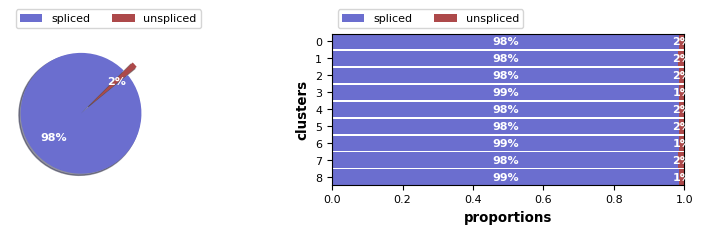

In [9]:
#os.mkdir('../results/velocyto/plots')
plot_prop_cre3 = scv.pl.proportions(sample_cre3, show = False)
scv.pl.utils.savefig_or_show(save = 'cre3_proportions_spliced_unspliced.svg')

<br>

<br>

<br>

<br>

### RNA-velocity UMAP - Cre3

<br>

The RNA velocities projected into the cells or as streamlines are displayed below. 

<br>

Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:25) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:45) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_cre3_RNA_velocity_cells_UMAP.svg


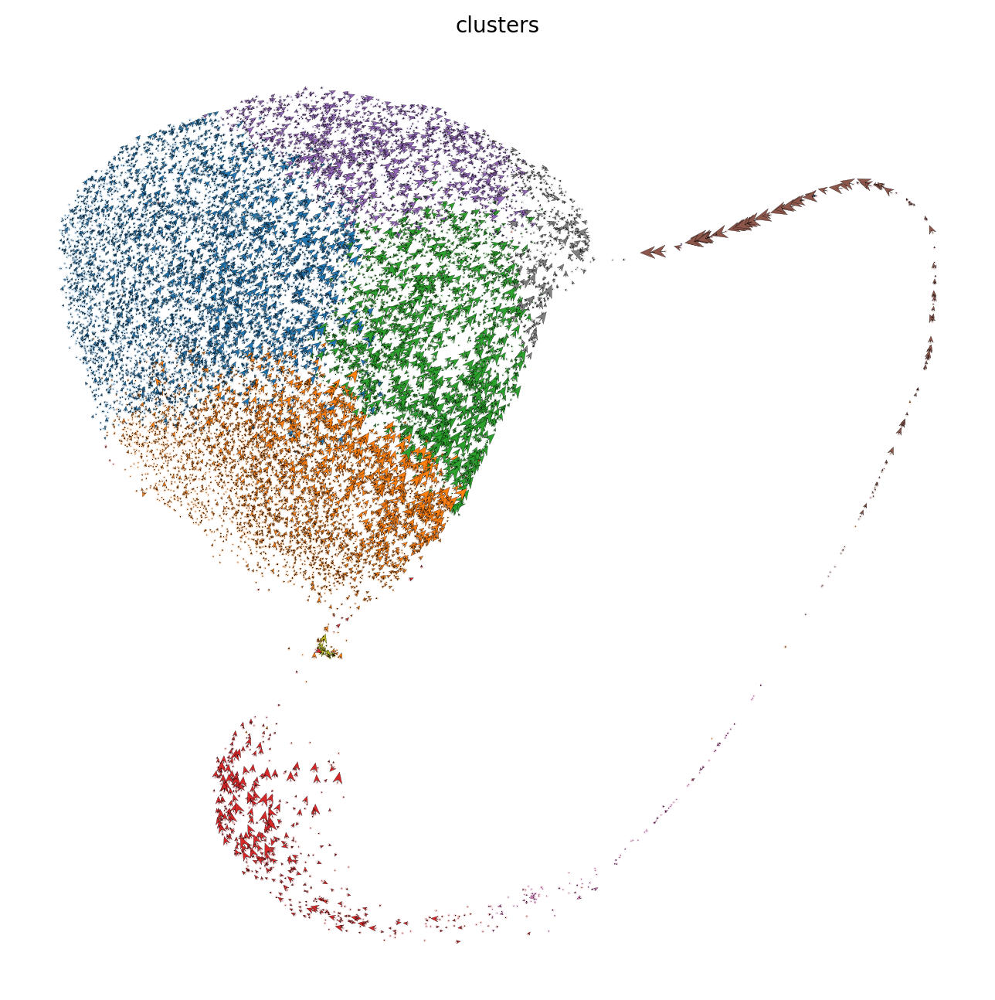

saving figure to file ./figures/scvelo_cre3_RNA_velocity_stream_UMAP.svg


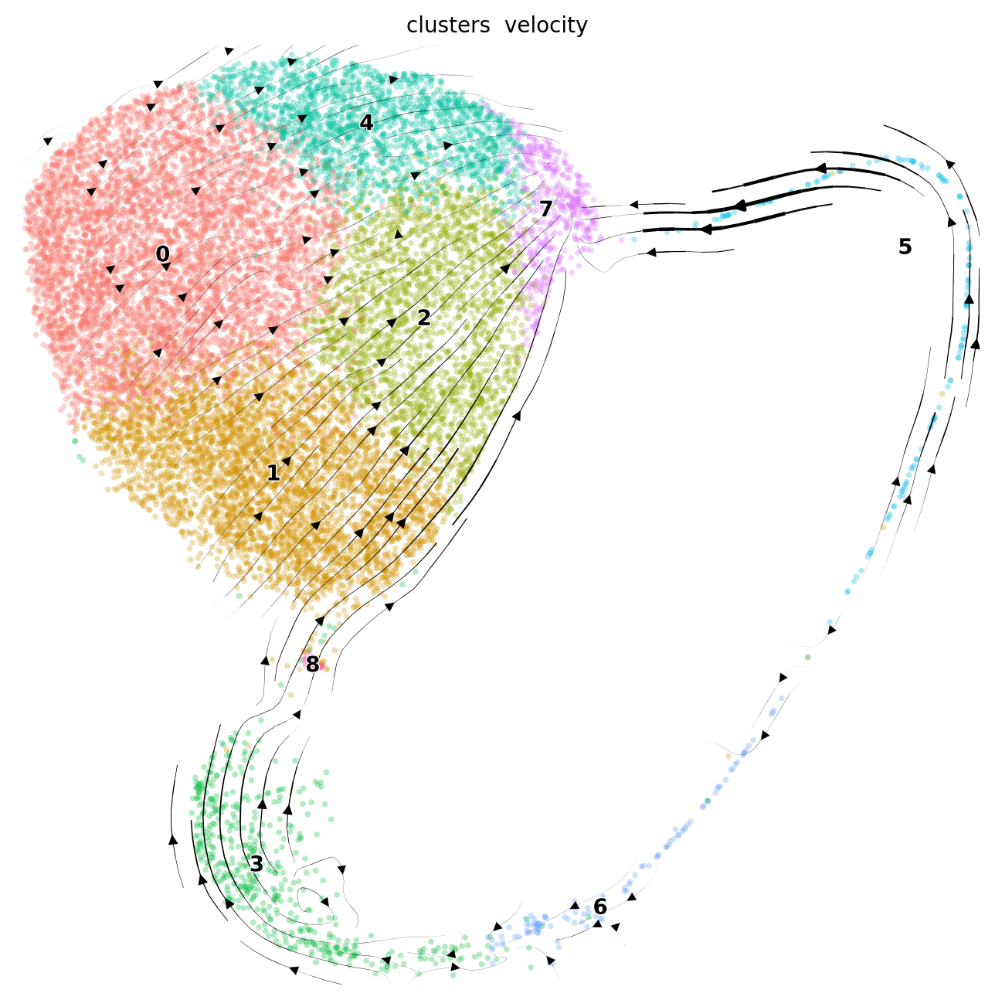

In [10]:
## RNA velocity

# define colors for both
color = ["#F8766D", "#D39200", "#93AA00", "#00BA38", "#00C19F", "#00B9E3", "#619CFF", "#DB72FB", "#FF61C3"]

# Cre3
scv.set_figure_params(facecolor="white", figsize=(8, 8))
random.seed(1024)
scv.pp.filter_and_normalize(sample_cre3)
scv.pp.moments(sample_cre3)
scv.tl.velocity(sample_cre3, mode = "stochastic")
scv.tl.velocity_graph(sample_cre3)
scv.set_figure_params(facecolor="white", figsize=(8, 8), fontsize = 10, 
                      dpi = 100, dpi_save = 300)
scv.pl.velocity_embedding(sample_cre3, basis = 'umap', arrow_size = 30, arrow_length = 3,
                          save = "cre3_RNA_velocity_cells_UMAP.svg")
scv.pl.velocity_embedding_stream(sample_cre3, layer=['velocity'], palette = color, 
                                 size = 30, save = 'cre3_RNA_velocity_stream_UMAP.svg')

<br>

<br>

### Unspliced fraction UMAP - Cre3 

<br>

The unspliced fraction (the portion of unspliced counts over spliced plus unspliced counts) was projected in the UMAP below.

<br>


saving figure to file ./figures/scvelo_cre3_unspliced_fraction_UMAP.svg


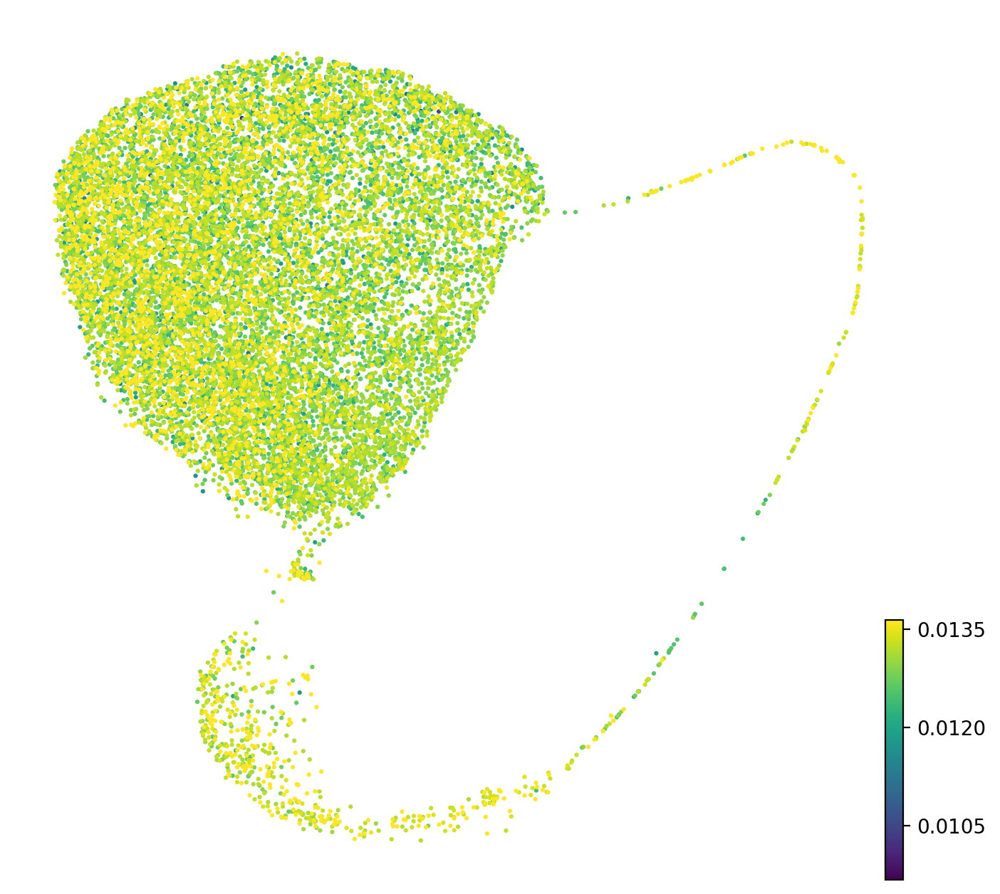

In [11]:
## plot scatter of unspliced fraction
# Cre3
counts_s_cre3 = scv.utils.sum_var(sample_cre3.layers['spliced'])
counts_u_cre3 = scv.utils.sum_var(sample_cre3.layers['unspliced'])
fractions_u_cre3 = counts_u_cre3 / (counts_s_cre3 + counts_u_cre3)
scv.pl.scatter(sample_cre3, color = fractions_u_cre3, 
               smooth=True, size = 20, color_map = 'viridis', 
               save = "cre3_unspliced_fraction_UMAP.svg")


<br>

<br>

### Pseudotime - Cre3

<br>



The velocity pseudotime UMAP is found below. To learn more about its meaning, please click in the [link](https://scvelo.readthedocs.io/VelocityBasics/#Velocity-graph-and-pseudotime). 

<br>

computing terminal states
    identified 9 regions of root cells and 1 region of end points .
    finished (0:00:06) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
saving figure to file ./figures/scvelo_cre3_pseudotime_UMAP.svg


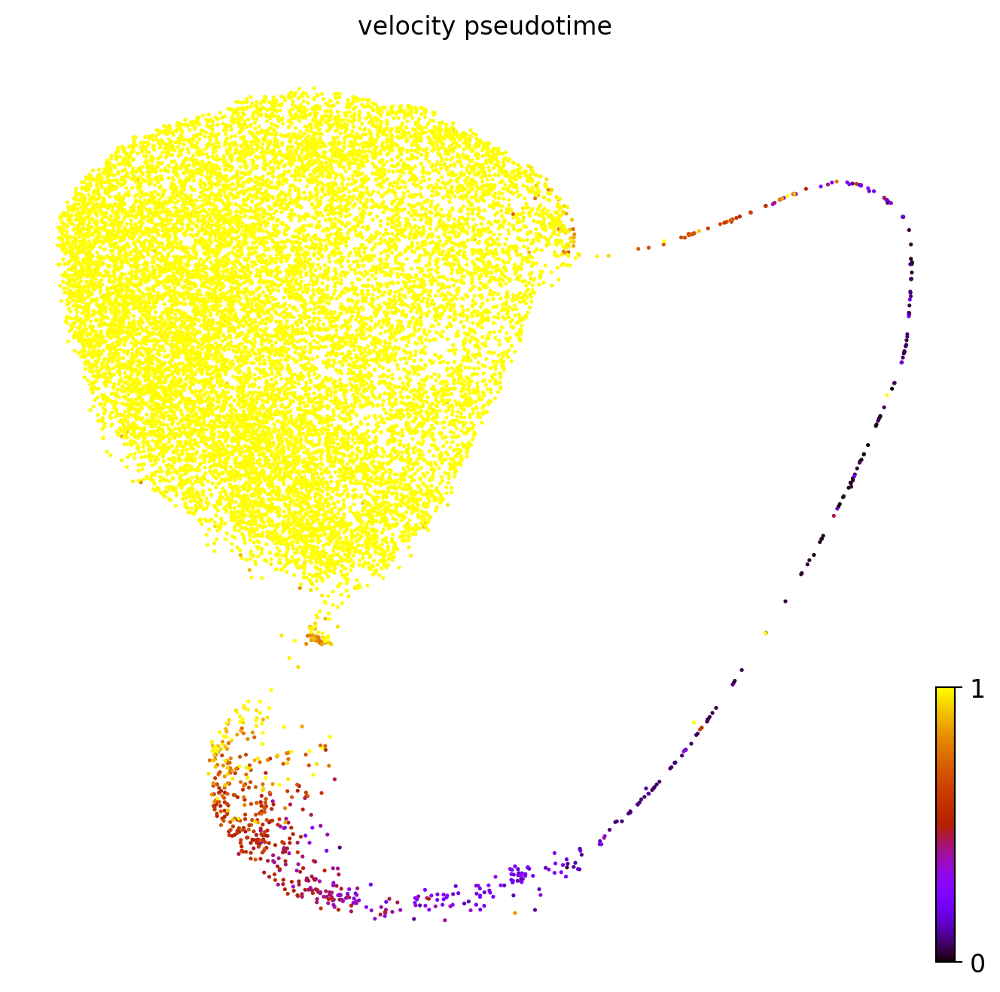

In [12]:
## Plotting pseudotime
scv.set_figure_params(facecolor="white", figsize=(8, 8))
random.seed(1024)
scv.tl.velocity_pseudotime(sample_cre3)
scv.pl.scatter(sample_cre3, color='velocity_pseudotime', cmap='gnuplot', 
               save = "cre3_pseudotime_UMAP.svg")

<br>

<br>

<br>

<br>

### Identify trajectory genes by cluster - Cre3

<br>

Below it was identified the most important genes for the RNA-velocity analysis *per* cluster. They were exported to a table at: `results/velocyto/tables/cre3_velocity_genes_by_cluster.tsv`. 

In addition 5 genes *per* cluster are represented below. 

<br>

In [13]:
## Identify important velocity genes by cluster
tables2save = "../results/velocyto/tables"
try:
    os.mkdir(tables2save)
except:
    next     
random.seed(1024)
scv.tl.rank_velocity_genes(sample_cre3, groupby='clusters', min_corr=.3)
genes_tbl_cre3 = scv.DataFrame(sample_cre3.uns['rank_velocity_genes']['names'])
genes_tbl_cre3.to_csv(tables2save + '/' + 'cre3_velocity_genes_by_cluster.tsv', sep='\t', index=False, header=True)

ranking velocity genes
    finished (0:00:17) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


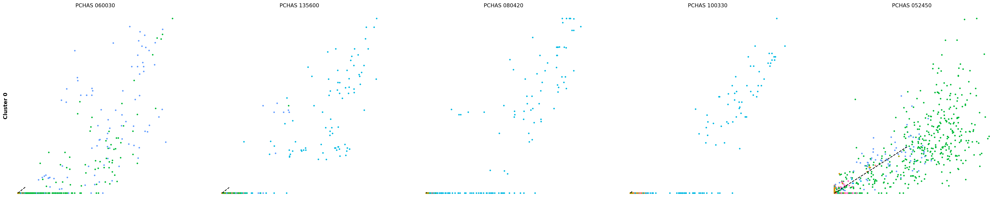

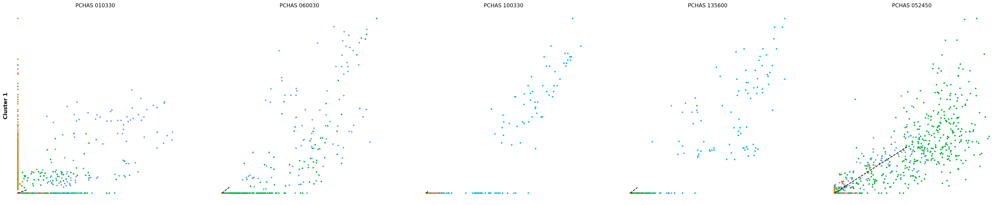

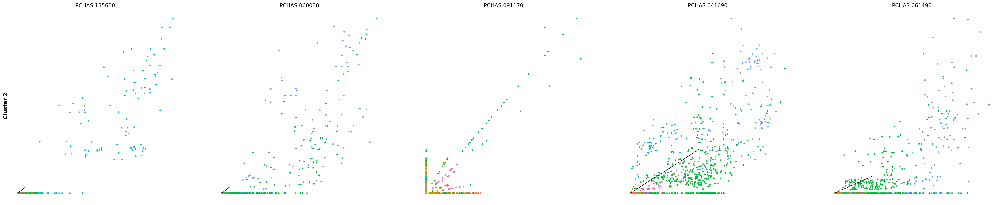

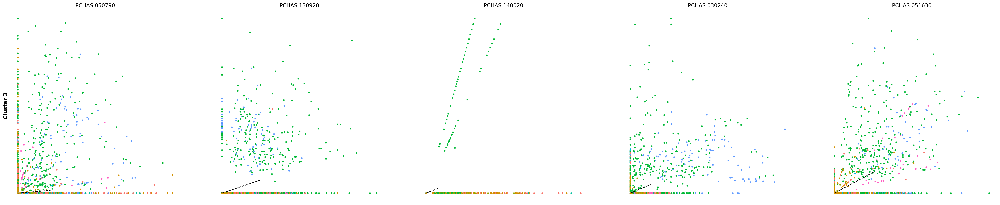

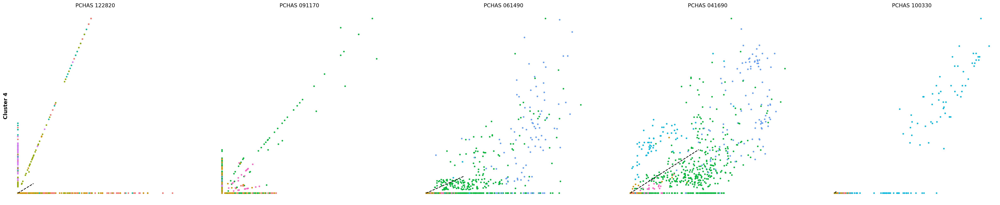

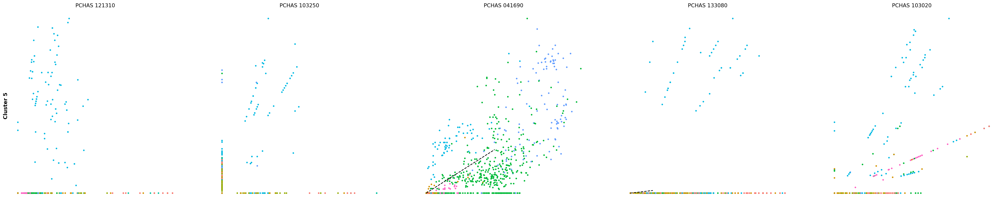

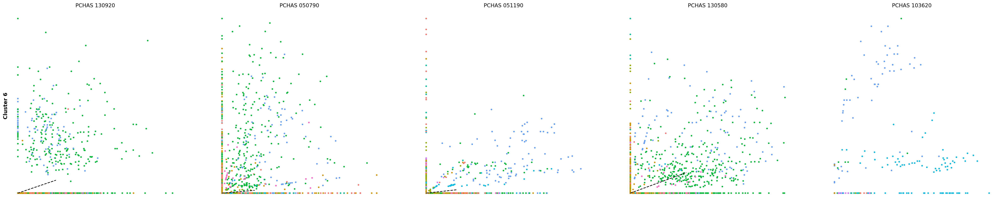

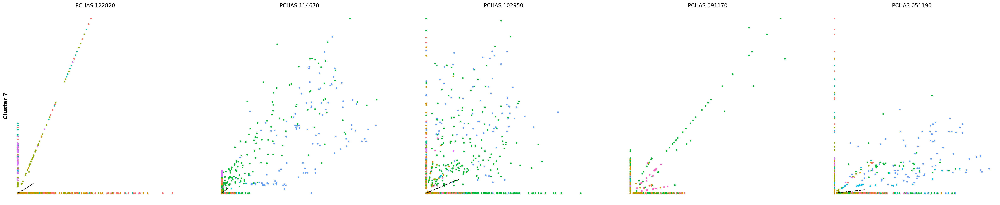

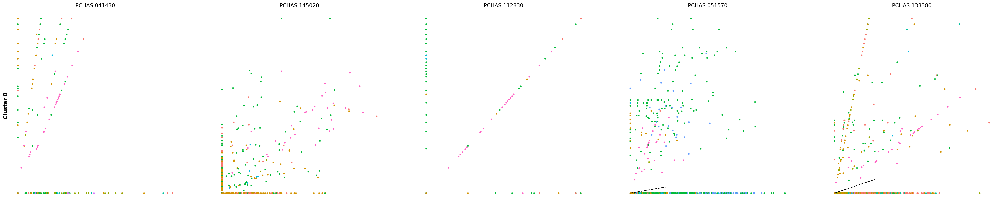

In [14]:
## Plot top 5 velocity genes
kwargs = dict(frameon=False, size=50, linewidth=1.5)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['0'][:5], ylabel='Cluster 0', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['1'][:5], ylabel='Cluster 1', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['2'][:5], ylabel='Cluster 2', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['3'][:5], ylabel='Cluster 3', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['4'][:5], ylabel='Cluster 4', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['5'][:5], ylabel='Cluster 5', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['6'][:5], ylabel='Cluster 6', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['7'][:5], ylabel='Cluster 7', **kwargs)
scv.pl.scatter(sample_cre3, genes_tbl_cre3['8'][:5], ylabel='Cluster 8', **kwargs)

<br>

<br>

<br>

<br>

### Speed & conherence - Cre3

<br>

The velocity length and conherence are presented below. Please have a look into the [official documentation](https://scvelo.readthedocs.io/VelocityBasics/#Speed-and-coherence) for a correct interpretation. 

<br>

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)
saving figure to file ./figures/scvelo_cre3_speed_confidence_UMAPs.svg


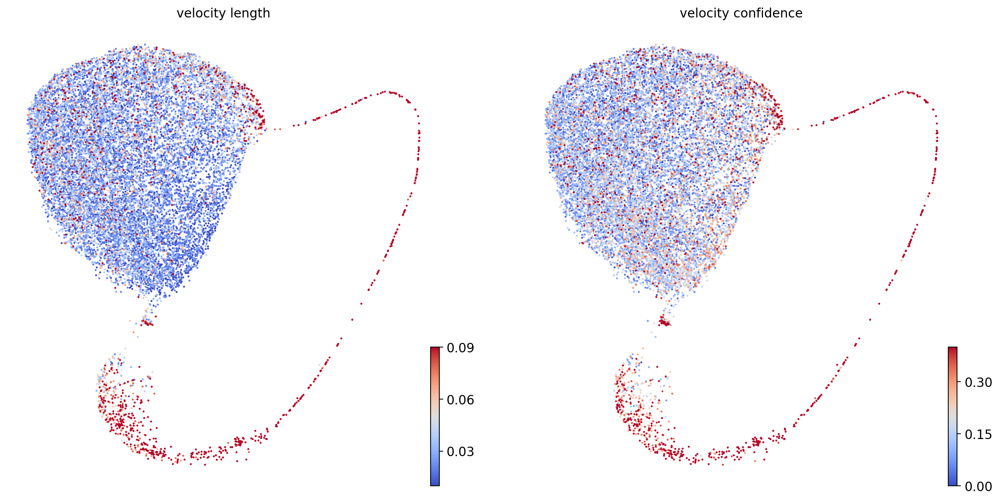

In [15]:
## Speed & confidence
random.seed(1024)
scv.tl.velocity_confidence(sample_cre3)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(sample_cre3, c=keys, cmap='coolwarm', perc=[5, 95], 
              save = "cre3_speed_confidence_UMAPs.svg")

In [16]:
speed_coherence_cre3 = sample_cre3.obs.groupby('clusters')[keys].mean().T
speed_coherence_cre3.style.background_gradient(cmap='coolwarm', axis=1)

clusters,0,1,2,3,4,5,6,7,8
velocity_length,0.028809,0.024993,0.024593,0.089184,0.034316,0.165362,0.126381,0.048684,0.068710
velocity_confidence,0.115795,0.136369,0.137246,0.341598,0.127454,0.661298,0.564971,0.218790,0.473738




<brconherence>

<br>

<br>

---

<br>

<br>

### Estimate RNA-velocity & projecting trajectories through UMAP - Lox2

<br>



### Spliced/unspliced fractions - Lox2

<br>

The percentage of overall spliced and unspliced fractions as well as discriminated by cluster is presented below. 

saving figure to file ./figures/scvelo_lox2_proportions_spliced_unspliced.svg


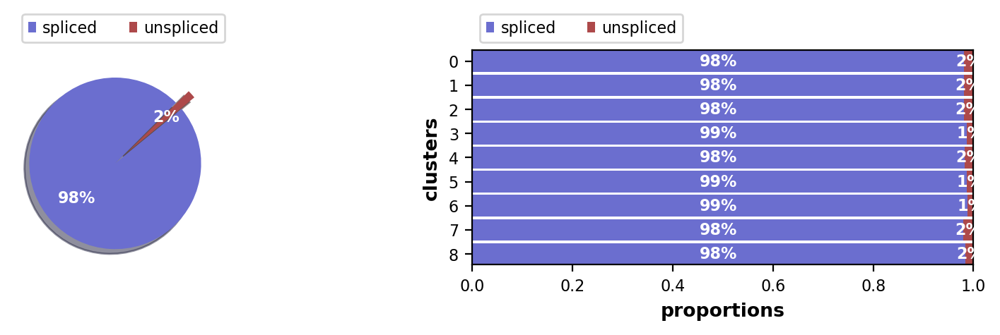

In [17]:
plot_prop_lox2 = scv.pl.proportions(sample_lox2, show = False)
scv.pl.utils.savefig_or_show(save = 'lox2_proportions_spliced_unspliced.svg')

<br>

<br>

<br>

<br>

### RNA-velocity UMAP - Lox2

<br>

The RNA velocities projected into the cells or as streamlines are displayed below. 

<br>

Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:09) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_lox2_RNA_velocity_cells_UMAP.svg


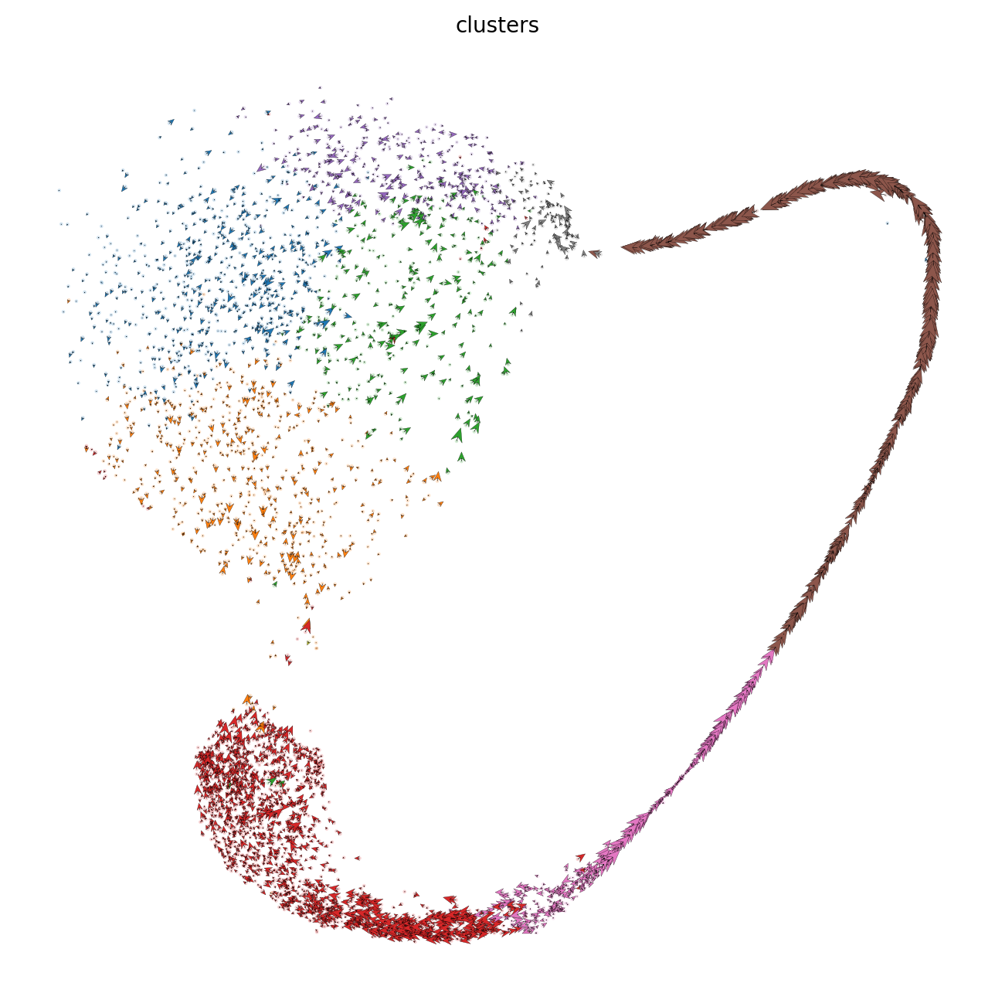

saving figure to file ./figures/scvelo_lox2_RNA_velocity_stream_UMAP.svg


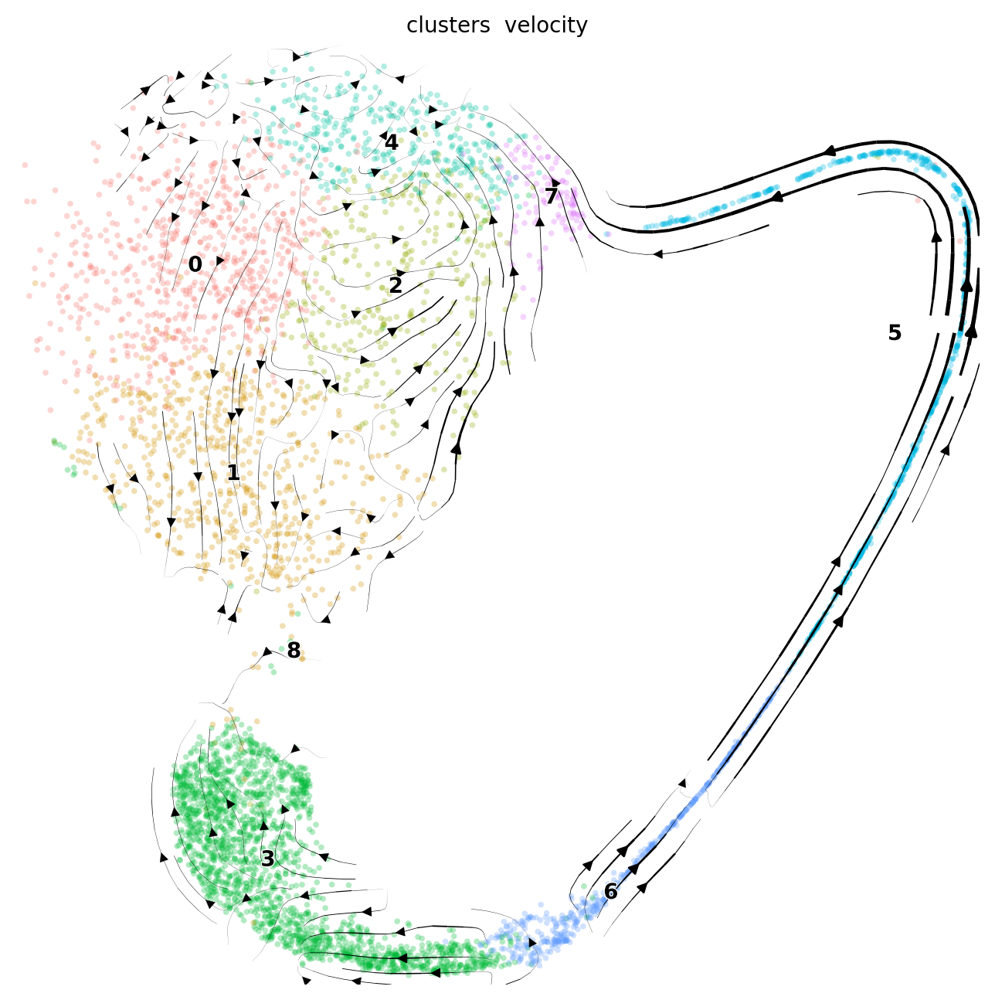

In [18]:
# Lox2
scv.set_figure_params(facecolor="white", figsize=(8, 8))
random.seed(1024)
scv.pp.filter_and_normalize(sample_lox2)
scv.pp.moments(sample_lox2)
scv.tl.velocity(sample_lox2, mode = "stochastic")
scv.tl.velocity_graph(sample_lox2)
scv.set_figure_params(facecolor="white", figsize=(8, 8), fontsize = 10, 
                      dpi = 100, dpi_save = 300)
scv.pl.velocity_embedding(sample_lox2, basis = 'umap', arrow_size = 30, arrow_length = 3,
                          save = "lox2_RNA_velocity_cells_UMAP.svg")
scv.pl.velocity_embedding_stream(sample_lox2, layer=['velocity'], size = 30,
                                 palette = color,save = 'lox2_RNA_velocity_stream_UMAP.svg')


<br>

<br>

<br>

<br>

#### Unspliced fraction UMAP - Lox2 

<br>

The unspliced fraction (the portion of unspliced counts over spliced plus unspliced counts) was projected in the UMAP below.

<br>


saving figure to file ./figures/scvelo_lox2_unspliced_fraction_UMAP.svg


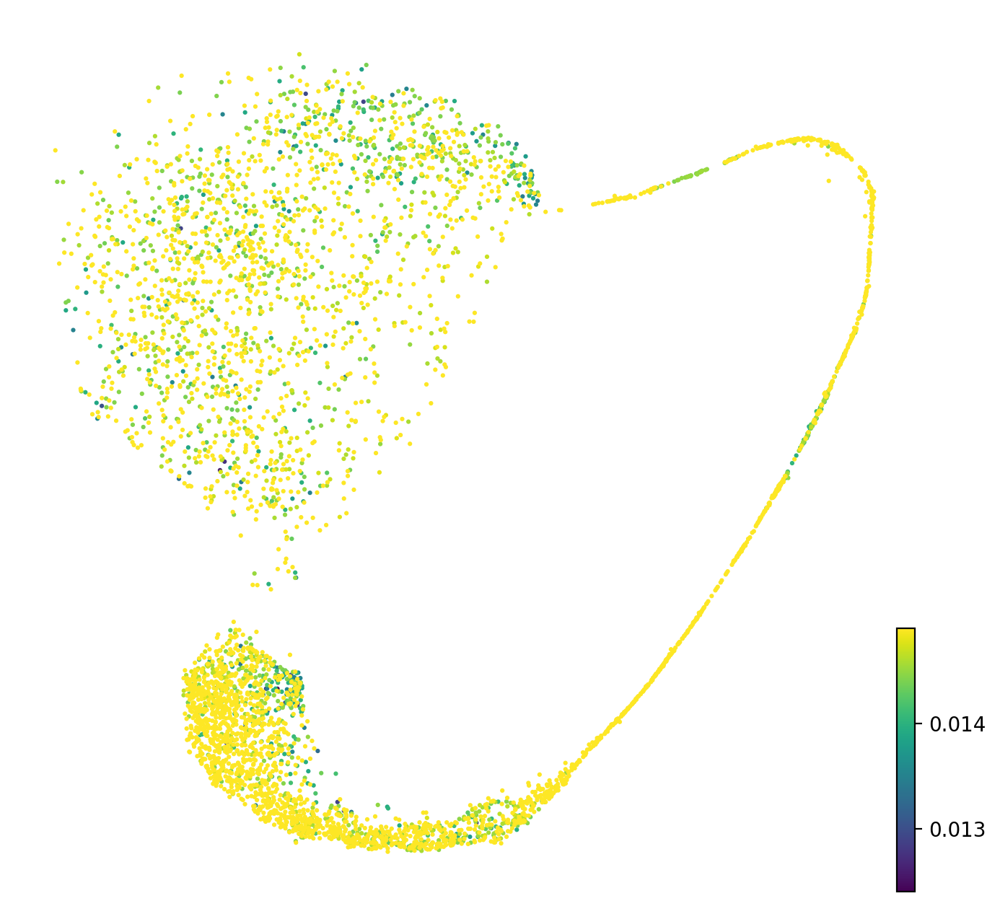

In [19]:
## plot scatter of unspliced fraction
# Lox2
counts_s_lox2 = scv.utils.sum_var(sample_lox2.layers['spliced'])
counts_u_lox2 = scv.utils.sum_var(sample_lox2.layers['unspliced'])
fractions_u_lox2 = counts_u_lox2 / (counts_s_lox2 + counts_u_lox2)
scv.pl.scatter(sample_lox2, color = fractions_u_lox2, 
               smooth=True, size = 20, color_map = 'viridis', 
               save = "lox2_unspliced_fraction_UMAP.svg")


<br>

<br>

<br>

<br>

### Pseudotime - Lox2

<br>



The velocity pseudotime UMAP is found below. To learn more about its meaning, please click in the [link](https://scvelo.readthedocs.io/VelocityBasics/#Velocity-graph-and-pseudotime). 

<br>

computing terminal states
    identified 4 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
saving figure to file ./figures/scvelo_lox2_pseudotime_UMAP.svg


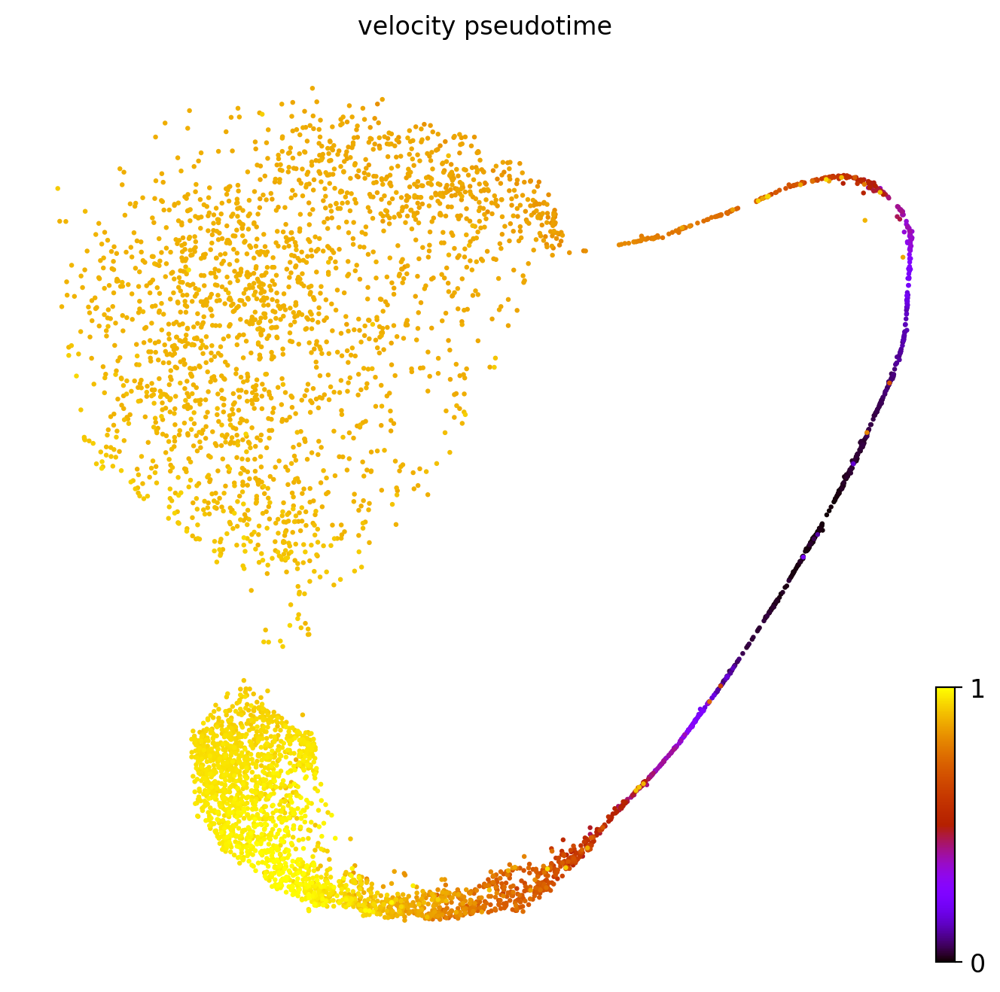

In [20]:
scv.set_figure_params(facecolor="white", figsize=(8, 8))
random.seed(1024)
scv.tl.velocity_pseudotime(sample_lox2)
scv.pl.scatter(sample_lox2, color='velocity_pseudotime', cmap='gnuplot', 
               save = "lox2_pseudotime_UMAP.svg")

<br>

<br>

<br>

<br>

### Identify trajectory genes by cluster - Lox2

<br>


Below it was identified the most important genes for the RNA-velocity analysis *per* cluster. They were exported to a table at: `results/velocyto/tables/lox2_velocity_genes_by_cluster.tsv`. 

In addition  5 genes *per* cluster are represented below. 

<br>

In [21]:
## Identify important velocity genes by cluster
random.seed(1024)
scv.tl.rank_velocity_genes(sample_lox2, groupby='clusters', min_corr=.3)
genes_tbl_lox2 = scv.DataFrame(sample_lox2.uns['rank_velocity_genes']['names'])
genes_tbl_lox2.to_csv(tables2save + '/' + 'lox2_velocity_genes_by_cluster.tsv', sep='\t', index=False, header=True)

ranking velocity genes
    finished (0:00:06) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


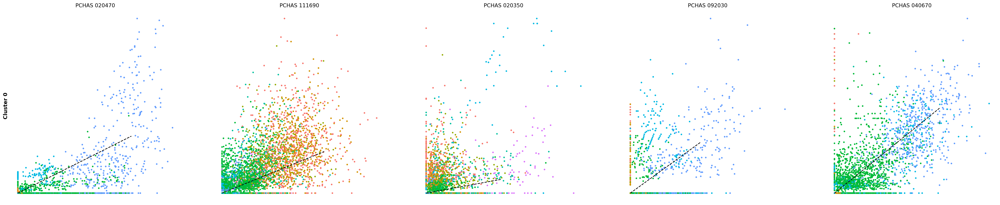

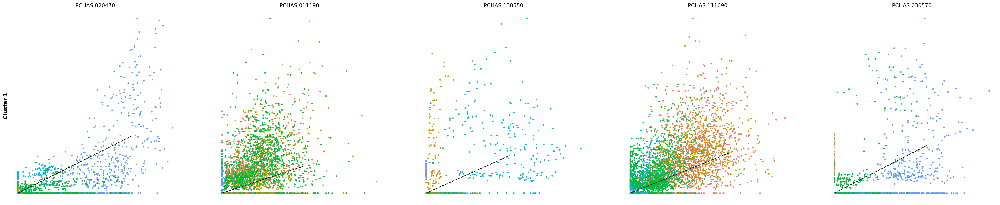

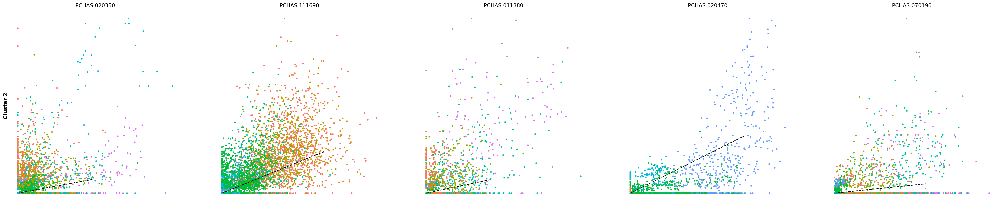

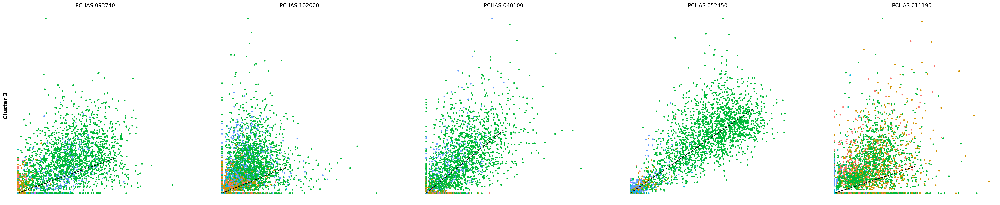

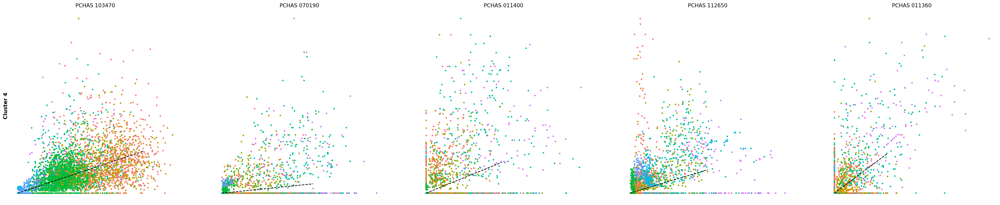

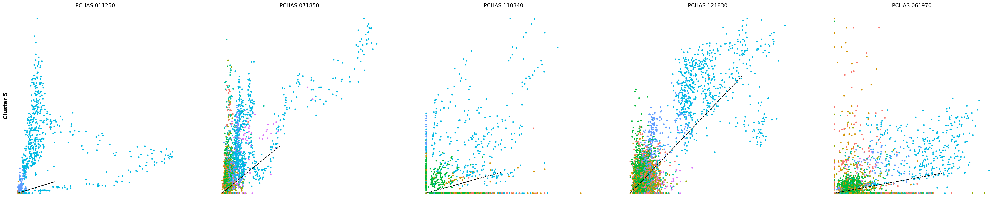

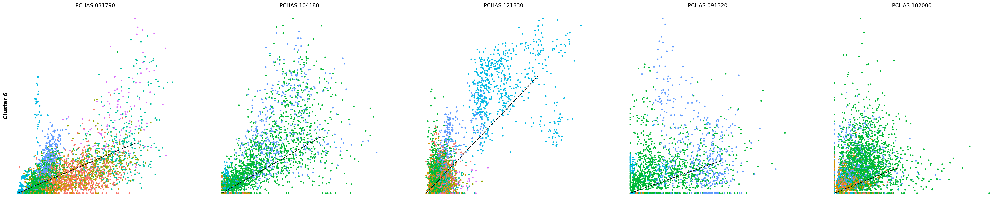

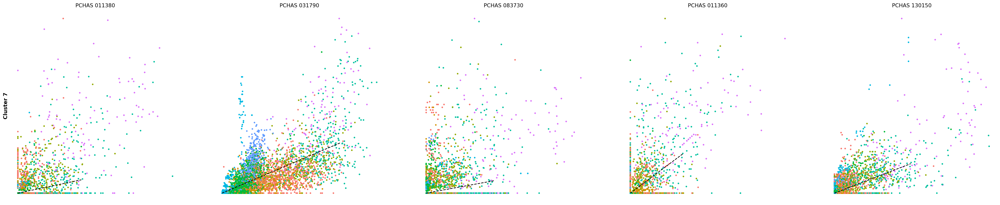

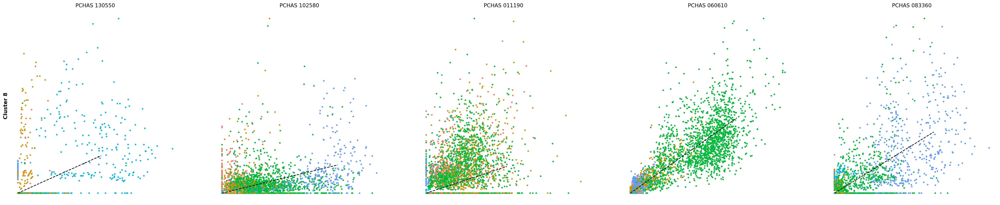

In [22]:
## Plot top 5 velocity genes
kwargs = dict(frameon=False, size=50, linewidth=1.5)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['0'][:5], ylabel='Cluster 0', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['1'][:5], ylabel='Cluster 1', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['2'][:5], ylabel='Cluster 2', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['3'][:5], ylabel='Cluster 3', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['4'][:5], ylabel='Cluster 4', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['5'][:5], ylabel='Cluster 5', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['6'][:5], ylabel='Cluster 6', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['7'][:5], ylabel='Cluster 7', **kwargs)
scv.pl.scatter(sample_lox2, genes_tbl_lox2['8'][:5], ylabel='Cluster 8', **kwargs)

<br>

<br>

<br>

<br>

### Speed & conherence - Lox2

<br>

The velocity length and conherence are presented below. Please have a look into the [official documentation](https://scvelo.readthedocs.io/VelocityBasics/#Speed-and-coherence) for a correct interpretation. 

<br>

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)
saving figure to file ./figures/scvelo_lox2_speed_confidence_UMAPs.svg


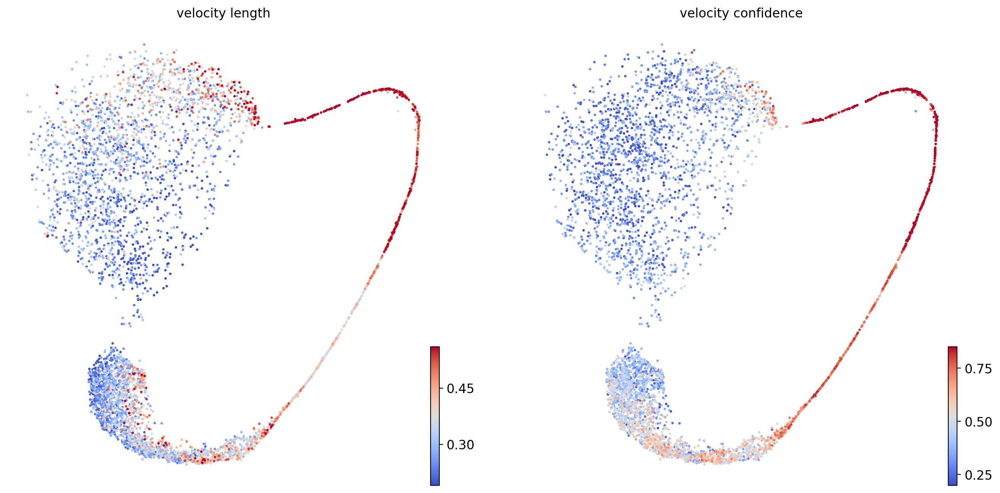

In [23]:
## Speed & confidence
random.seed(1024)
scv.tl.velocity_confidence(sample_lox2)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(sample_lox2, c=keys, cmap='coolwarm', perc=[5, 95], 
              save = "lox2_speed_confidence_UMAPs.svg")

In [24]:
speed_coherence_lox2 = sample_lox2.obs.groupby('clusters')[keys].mean().T
speed_coherence_lox2.style.background_gradient(cmap='coolwarm', axis=1)

clusters,0,1,2,3,4,5,6,7,8
velocity_length,0.301794,0.250194,0.278705,0.304150,0.378512,0.515600,0.375602,0.452269,0.220000
velocity_confidence,0.282149,0.316261,0.334710,0.437468,0.357296,0.795684,0.617811,0.544891,0.423372
